Copyright 2020 DeepMind Technologies Limited

Licensed under the Apache License, Version 2.0 (the "License");
you may not use this file except in compliance with the License.
You may obtain a copy of the License at

     https://www.apache.org/licenses/LICENSE-2.0

Unless required by applicable law or agreed to in writing, software
distributed under the License is distributed on an "AS IS" BASIS,
WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
See the License for the specific language governing permissions and
limitations under the License.

## Clone repo and import dependencies

In [1]:
!pip install notebook

/bin/bash: /home/deria/anaconda3/envs/AnkurTF2/lib/libtinfo.so.6: no version information available (required by /bin/bash)


In [2]:
import objaverse
import multiprocessing
import random
import trimesh

processes = multiprocessing.cpu_count()
random.seed(42)
uids = objaverse.load_uids()
random_object_uids = random.sample(uids, 4)
steak_uids = ['b47dc21973344b779445f4e1511a8042',]
plate_uids = [ 'e91f046f7d5c4dbda1571259b0460782',]
fork_uids = [ 'b40f7ac290d241aba9027c6cabe222c1', ]
knife_uids = ['aa5b9a4041d245e894473ce681a94d6f', ]
random_object_uids = [*random.sample(steak_uids, 1), *random.sample(plate_uids, 1), *random.sample(fork_uids, 1), *random.sample(knife_uids, 1)]
print(random_object_uids)
objects = objaverse.load_objects(
    uids=random_object_uids,
    download_processes=processes
)


['b47dc21973344b779445f4e1511a8042', 'e91f046f7d5c4dbda1571259b0460782', 'b40f7ac290d241aba9027c6cabe222c1', 'aa5b9a4041d245e894473ce681a94d6f']


In [3]:
meshes = []
for uid, path in objects.items():
    scene = trimesh.load(path)
    geometries = list(scene.geometry.values())
    geometry = geometries[0]
    meshes.append(geometry)

In [25]:


import os
import numpy as np
import tensorflow as tf
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR) # Hide TF deprecation messages
import matplotlib.pyplot as plt

import modules
import data_utils

## Prepare a synthetic dataset
We prepare a dataset of meshes using four simple geometric primitives.

The important function here is `data_utils.load_process_mesh`, which loads the raw `.obj` file, normalizes and centers the meshes, and applies quantization to the vertex positions. The mesh faces are flattened and treated as a long sequence, with a new-face token (`=1`) separating the faces. For each of the four synthetic meshes, we associate a unique class label, so we can train class-conditional models.

After processing the raw mesh data into numpy arrays, we create a `tf.data.Dataset` that we can use to feed data to our models. 

current object =  0
current object =  1
current object =  2
current object =  3
Device mapping:
/job:localhost/replica:0/task:0/device:GPU:0 -> device: 0, name: NVIDIA GeForce RTX 3060, pci bus id: 0000:b3:00.0, compute capability: 8.6



2023-07-02 05:08:24.376686: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1635] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 8877 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3060, pci bus id: 0000:b3:00.0, compute capability: 8.6


TensorDataset: (TensorDataset): /job:localhost/replica:0/task:0/device:CPU:0
FlatMapDataset: (FlatMapDataset): /job:localhost/replica:0/task:0/device:CPU:0
IteratorToStringHandle: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
IteratorGetNext: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
MapDataset: (MapDataset): /job:localhost/replica:0/task:0/device:CPU:0
RepeatDataset: (RepeatDataset): /job:localhost/replica:0/task:0/device:CPU:0
PaddedBatchDatasetV2: (PaddedBatchDatasetV2): /job:localhost/replica:0/task:0/device:CPU:0
PrefetchDataset: (PrefetchDataset): /job:localhost/replica:0/task:0/device:CPU:0
IteratorToStringHandle_1: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
IteratorGetNext_1: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/class_label/embeddings/Initializer/random_uniform/RandomUniform: (RandomUniform): /job:localhost/replica:0/task:0/device:GPU:0
vertex_model/class_label/emb

2023-07-02 05:08:24.807991: I tensorflow/core/common_runtime/placer.cc:114] TensorDataset: (TensorDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:24.808018: I tensorflow/core/common_runtime/placer.cc:114] FlatMapDataset: (FlatMapDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:24.808023: I tensorflow/core/common_runtime/placer.cc:114] IteratorToStringHandle: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:24.808027: I tensorflow/core/common_runtime/placer.cc:114] IteratorGetNext: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:24.808031: I tensorflow/core/common_runtime/placer.cc:114] MapDataset: (MapDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:24.808035: I tensorflow/core/common_runtime/placer.cc:114] RepeatDataset: (RepeatDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:24.808039: I tensorflow/core/common_runtime/pla

face_model_1/face_model/create_dist/transformer_decoder/layer_0/cross_attention_1/combine_heads/combine_last_two_dimensions/strided_slice/stack: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_0/cross_attention_1/combine_heads/combine_last_two_dimensions/strided_slice/stack_1: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_0/cross_attention_1/combine_heads/combine_last_two_dimensions/strided_slice/stack_2: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_0/cross_attention_1/combine_heads/combine_last_two_dimensions/strided_slice_1/stack: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_0/cross_attention_1/combine_heads/combine_last_two_dimensions/strided_slice_1/stack_1: (Const): /job:localhost/replica:0/task:0/device:G

el/embed_vertices/transformer_encoder/layer_0/self_attention_1/split_heads_2/split_last_dimension/strided_slice/stack: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:25.030820: I tensorflow/core/common_runtime/placer.cc:114] face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_0/self_attention_1/split_heads_2/split_last_dimension/strided_slice/stack_1: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:25.030824: I tensorflow/core/common_runtime/placer.cc:114] face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_0/self_attention_1/split_heads_2/split_last_dimension/strided_slice/stack_2: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:25.030831: I tensorflow/core/common_runtime/placer.cc:114] face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_0/self_attention_1/split_heads_2/split_last_dimension/Reshape/shape/1: (Const): /job:localhost/repli

face_model_4/face_model/create_dist/transformer_decoder/layer_1/fc_1/Tensordot/Const: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_1/fc_1/Tensordot/Const_1: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_1/fc_1/Tensordot/concat/axis: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_1/fc_1/Tensordot/Const_2: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_1/fc_1/Tensordot/concat_1/axis: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_1/fc_2/Tensordot/axes: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_1/fc_2/Tensordot/free: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face

2023-07-02 05:08:25.269219: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot/axes: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:25.269226: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot/free: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:25.269233: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot/GatherV2/axis: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:25.269241: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot/GatherV2_1/axis: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:25.269250: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transfor

args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
GeneratorDataset: (GeneratorDataset): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
FakeSink0: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
identity_RetVal: (_Retval): /job:localhost/replica:0/task:0/device:CPU:0
args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
FakeSink0: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
identity_RetVal: (_Retval): /job:localhost/replica:0/task:0/device:CPU:0
PyFunc: (PyFunc): /job:localhost/replica:0/task:0/device:CPU:0
args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
PyFunc: (PyFunc): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Iden

2023-07-02 05:08:25.498217: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]
2023-07-02 05:08:25.502709: I tensorflow/core/common_runtime/placer.cc:114] args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.502727: I tensorflow/core/common_runtime/placer.cc:114] GeneratorDataset: (GeneratorDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.502732: I tensorflow/core/common_runtime/placer.cc:114] NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.502736: I tensorflow/core/common_runtime/placer.cc:114] Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.502740: I tensorflow/core/common_runtime/placer.cc:114] FakeSink0: (Identity): /

TensorDataset: (TensorDataset): /job:localhost/replica:0/task:0/device:CPU:0
FlatMapDataset: (FlatMapDataset): /job:localhost/replica:0/task:0/device:CPU:0
IteratorToStringHandle: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
IteratorGetNext: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
MapDataset: (MapDataset): /job:localhost/replica:0/task:0/device:CPU:0
RepeatDataset: (RepeatDataset): /job:localhost/replica:0/task:0/device:CPU:0
PaddedBatchDatasetV2: (PaddedBatchDatasetV2): /job:localhost/replica:0/task:0/device:CPU:0
PrefetchDataset: (PrefetchDataset): /job:localhost/replica:0/task:0/device:CPU:0
IteratorToStringHandle_1: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
IteratorGetNext_1: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/class_label/embeddings/Initializer/random_uniform/RandomUniform: (RandomUniform): /job:localhost/replica:0/task:0/device:GPU:0
vertex_model/class_label/emb

2023-07-02 05:08:25.951901: I tensorflow/core/common_runtime/placer.cc:114] TensorDataset: (TensorDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.951929: I tensorflow/core/common_runtime/placer.cc:114] FlatMapDataset: (FlatMapDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.951934: I tensorflow/core/common_runtime/placer.cc:114] IteratorToStringHandle: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.951940: I tensorflow/core/common_runtime/placer.cc:114] IteratorGetNext: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.951944: I tensorflow/core/common_runtime/placer.cc:114] MapDataset: (MapDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.951948: I tensorflow/core/common_runtime/placer.cc:114] RepeatDataset: (RepeatDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:25.951954: I tensorflow/core/common_runtime/pla

gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention/mul_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention/sub_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention/sub_grad/Shape_1: (Shape): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention/sub_grad/BroadcastGradientArgs: (BroadcastGradientArgs): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention/sub_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention/sub_grad/Reshape: (Reshape): /job:localhost/

/job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.346739: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/face_model/embed_inputs/GatherV2_grad/strided_slice_1/stack_2: (Pack): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.346747: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/face_model/embed_inputs/GatherV2_grad/strided_slice_1: (StridedSlice): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.346755: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/face_model/embed_inputs/GatherV2_grad/strided_slice_2: (StridedSlice): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.346763: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/face_model/embed_inputs/GatherV2_grad/concat: (ConcatV2): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-

gradients_1/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc/sub_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc/sub_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc/sub_grad/Neg: (Neg): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc/sub_grad/Sum_1: (Sum): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc/sub_grad/Reshape_1: (Reshape): /job:localhost/replica:0/task:0/device:GPU:0
gradients_1/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2

2023-07-02 05:08:26.632789: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/create_dist/mul_grad/Shape_1: (Shape): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.640241: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/create_dist/mul_grad/BroadcastGradientArgs: (BroadcastGradientArgs): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.640276: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/create_dist/mul_grad/Mul: (Mul): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.640295: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/create_dist/mul_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.640303: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/create_dist/mul_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:GPU:0


gradients_3/face_model_1/face_model/create_dist/transformer_decoder/layer_2/self_attention_1/dot_product_attention/MatMul_grad/Sum_1: (Sum): /job:localhost/replica:0/task:0/device:GPU:0
gradients_3/face_model_1/face_model/create_dist/transformer_decoder/layer_2/self_attention_1/dot_product_attention/MatMul_grad/Reshape_1: (Reshape): /job:localhost/replica:0/task:0/device:GPU:0
gradients_3/face_model_1/face_model/create_dist/transformer_decoder/layer_2/self_attention_1/dot_product_attention/MatMul_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:GPU:0
gradients_3/face_model_1/face_model/create_dist/transformer_decoder/layer_2/self_attention_1/dot_product_attention/MatMul_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:GPU:0
gradients_3/face_model_1/face_model/create_dist/transformer_decoder/layer_2/self_attention_1/dot_product_attention/MatMul_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:GPU:0


del/transformer_encoder/layer_0/self_attention/k/kernel/Adam_3/Initializer/zeros: (Fill): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.837341: I tensorflow/core/common_runtime/placer.cc:114] face_model/transformer_encoder/layer_0/self_attention/k/kernel/Adam_3: (VariableV2): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.837346: I tensorflow/core/common_runtime/placer.cc:114] face_model/transformer_encoder/layer_0/self_attention/k/kernel/Adam_3/Assign: (Assign): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.837352: I tensorflow/core/common_runtime/placer.cc:114] face_model/transformer_encoder/layer_0/self_attention/k/kernel/Adam_3/read: (Identity): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.837359: I tensorflow/core/common_runtime/placer.cc:114] face_model/transformer_encoder/layer_0/self_attention/v/kernel/Adam_2/Initializer/zeros: (Fill): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.837

face_model/transformer_decoder/layer_0/self_attention/k/kernel/Adam_2/Initializer/zeros: (Fill): /job:localhost/replica:0/task:0/device:GPU:0
face_model/transformer_decoder/layer_0/self_attention/k/kernel/Adam_2: (VariableV2): /job:localhost/replica:0/task:0/device:GPU:0
face_model/transformer_decoder/layer_0/self_attention/k/kernel/Adam_2/Assign: (Assign): /job:localhost/replica:0/task:0/device:GPU:0
face_model/transformer_decoder/layer_0/self_attention/k/kernel/Adam_2/read: (Identity): /job:localhost/replica:0/task:0/device:GPU:0
face_model/transformer_decoder/layer_0/self_attention/k/kernel/Adam_3/Initializer/zeros: (Fill): /job:localhost/replica:0/task:0/device:GPU:0
face_model/transformer_decoder/layer_0/self_attention/k/kernel/Adam_3: (VariableV2): /job:localhost/replica:0/task:0/device:GPU:0
face_model/transformer_decoder/layer_0/self_attention/k/kernel/Adam_3/Assign: (Assign): /job:localhost/replica:0/task:0/device:GPU:0
face_model/transformer_decoder/layer_0/self_attention/k/k

_1/dot_product_attention/MatMul_1: (BatchMatMulV2): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.998473: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_decoder/layer_0/self_attention_1/combine_heads/transpose: (Transpose): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.998486: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_decoder/layer_0/self_attention_1/combine_heads/combine_last_two_dimensions/Shape: (Shape): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.998498: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_decoder/layer_0/self_attention_1/combine_heads/combine_last_two_dimensions/strided_slice: (StridedSlice): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:26.998511: I tensorflow/core/common_runtime/placer.cc:114] face_model_4/face_model/create_dist/transformer_deco

face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot/MatMul: (MatMul): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot/concat_1: (ConcatV2): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/Tensordot: (Reshape): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_0/fc_2/BiasAdd: (BiasAdd): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_0/mul_2: (Mul): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_decoder/layer_0/add_2: (AddV2): /job:localhost/replica:0/task:0/device:GPU:0
face_model_4/face_model/create_dist/transformer_de

:0/device:GPU:0
2023-07-02 05:08:27.299343: I tensorflow/core/common_runtime/placer.cc:114] face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/q/Tensordot/GatherV2_1/axis: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.299352: I tensorflow/core/common_runtime/placer.cc:114] face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/q/Tensordot/Const: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.299360: I tensorflow/core/common_runtime/placer.cc:114] face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/q/Tensordot/Const_1: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.299368: I tensorflow/core/common_runtime/placer.cc:114] face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/q/Tensordot/concat/axis: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.299376: I tensorflow/c

replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/strided_slice_1/stack: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/strided_slice_1/stack_1: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/strided_slice_1/stack_2: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/Reshape/shape/2: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/Reshape/shape/3: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_mod

embeddings/Adam_2/Initializer/zeros/shape_as_tensor: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.535778: I tensorflow/core/common_runtime/placer.cc:114] vertex_model/value_embeddings/embeddings/Adam_2/Initializer/zeros/Const: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.535784: I tensorflow/core/common_runtime/placer.cc:114] vertex_model/value_embeddings/embeddings/Adam_3/Initializer/zeros/shape_as_tensor: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.535789: I tensorflow/core/common_runtime/placer.cc:114] vertex_model/value_embeddings/embeddings/Adam_3/Initializer/zeros/Const: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.535796: I tensorflow/core/common_runtime/placer.cc:114] vertex_model/transformer_decoder/layer_0/self_attention/layer_norm_scale/Adam_2/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:GPU:0
2023-07-02 05:08:27.535803: I tensorflow/core

t): /job:localhost/replica:0/task:0/device:GPU:0
face_model/project_to_pointers/kernel/Adam_2/Initializer/zeros/shape_as_tensor: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model/project_to_pointers/kernel/Adam_2/Initializer/zeros/Const: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model/project_to_pointers/kernel/Adam_3/Initializer/zeros/shape_as_tensor: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model/project_to_pointers/kernel/Adam_3/Initializer/zeros/Const: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model/project_to_pointers/bias/Adam_2/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:GPU:0
face_model/project_to_pointers/bias/Adam_3/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:GPU:0
Adam_3/learning_rate: (Const): /job:localhost/replica:0/task:0/device:GPU:0
Adam_3/beta1: (Const): /job:localhost/replica:0/task:0/device:GPU:0
Adam_3/beta2: (Const): /job:localhost/replica:0/task:0/devi

2023-07-02 05:08:28.089717: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]
2023-07-02 05:08:28.104695: I tensorflow/core/common_runtime/placer.cc:114] args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:28.104741: I tensorflow/core/common_runtime/placer.cc:114] GeneratorDataset: (GeneratorDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:28.104747: I tensorflow/core/common_runtime/placer.cc:114] NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:28.104752: I tensorflow/core/common_runtime/placer.cc:114] Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-02 05:08:28.104756: I tensorflow/core/common_runtime/placer.cc:114] FakeSink0: (Identity): /

args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
GeneratorDataset: (GeneratorDataset): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
FakeSink0: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
identity_RetVal: (_Retval): /job:localhost/replica:0/task:0/device:CPU:0
args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
FakeSink0: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
identity_RetVal: (_Retval): /job:localhost/replica:0/task:0/device:CPU:0
PyFunc: (PyFunc): /job:localhost/replica:0/task:0/device:CPU:0
args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
PyFunc: (PyFunc): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Iden

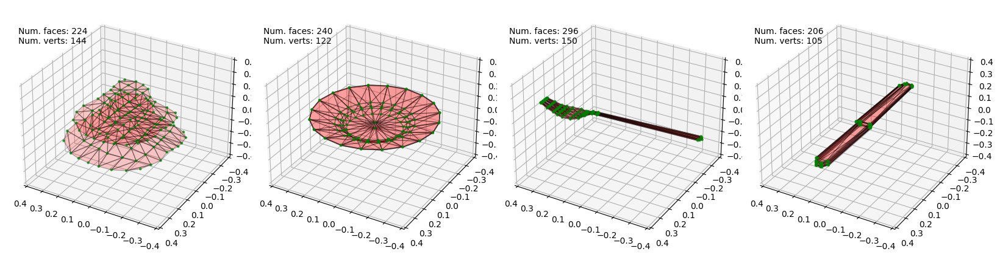

In [26]:
tf.compat.v1.disable_v2_behavior()
ex_list = []
max_verts  = 0
max_faces = 0
for k, (uid,path) in enumerate(objects.items()):
  print("current object = ", k)
  mesh_dict = data_utils.process_mesh_trimesh(list(trimesh.load(path).geometry.values())[0])
  if(mesh_dict['vertices'].shape[0] > max_verts):
    max_verts = mesh_dict['vertices'].shape[0]
  if(mesh_dict['faces'].shape[0] > max_faces):
    max_faces = mesh_dict['faces'].shape[0]
  mesh_dict['class_label'] = k
  ex_list.append(mesh_dict)
synthetic_dataset = tf.data.Dataset.from_generator(
    lambda: ex_list, 
    output_types={
        'vertices': tf.int32, 'faces': tf.int32, 'class_label': tf.int32},
    output_shapes={
        'vertices': tf.TensorShape([None, 3]), 'faces': tf.TensorShape([None]), 
        'class_label': tf.TensorShape(())}
    )
ex = tf.compat.v1.data.make_one_shot_iterator(synthetic_dataset).get_next()

# Inspect the first mesh
with tf.compat.v1.Session() as sess:
  ex_np = sess.run(ex)
print(ex_np)

# Plot the meshes
mesh_list = []
with tf.compat.v1.Session() as sess:
  for i in range(4):
    ex_np = sess.run(ex)
    mesh_list.append(
        {'vertices': data_utils.dequantize_verts(ex_np['vertices']), 
         'faces': data_utils.unflatten_faces(ex_np['faces'])})
data_utils.plot_meshes(mesh_list, ax_lims=0.4)

## Vertex model

#### Prepare the dataset for vertex model training
We need to perform some additional processing to make the dataset ready for vertex model training. In particular, `data_utils.make_vertex_model_dataset` flattens the `[V, 3]` vertex arrays, ordering by `Z->Y->X` coordinates. It also creates masks, which are used to mask padded elements in data batches. We also add random shifts to make the modelling task more challenging.

#### Create a vertex model
`modules.VertexModel` is a Sonnet module that. Calling the module on a batch of data will produce outputs which are the sequential predictions for each vertex coordinate. The basis of the vertex model is a Transformer decoder, and we specify it's parameters in `decoder_config`. 



In [6]:
print("max_verts = ", max_verts)
print("max_faces = ", max_faces)

max_verts =  150
max_faces =  1184


In [7]:
# Prepare the dataset for vertex model training
with tf.device('/gpu:0'):
    vertex_model_dataset = data_utils.make_vertex_model_dataset(
        synthetic_dataset, apply_random_shift=False)
    vertex_model_dataset = vertex_model_dataset.repeat()
    vertex_model_dataset = vertex_model_dataset.padded_batch(
        4, padded_shapes=vertex_model_dataset.output_shapes)
    vertex_model_dataset = vertex_model_dataset.prefetch(1)
    vertex_model_batch = vertex_model_dataset.make_one_shot_iterator().get_next()

    # Create vertex model
    vertex_model = modules.VertexModel(
        decoder_config={
            'hidden_size': 128,
            'fc_size': 512, 
            'num_layers': 3,
            'dropout_rate': 0.
        },
        class_conditional=True,
        num_classes=4,
        max_num_input_verts=250 ,  # number of vertices in the input mesh, if this is lower than the number of vertices in the mesh, there will be errors during training
        quantization_bits=8,
    )
    vertex_model_pred_dist = vertex_model(vertex_model_batch)
    vertex_model_loss = -tf.reduce_sum(
        vertex_model_pred_dist.log_prob(vertex_model_batch['vertices_flat']) * 
        vertex_model_batch['vertices_flat_mask'])
    vertex_samples = vertex_model.sample(
        4, context=vertex_model_batch, max_sample_length=200, top_p=0.95,
        recenter_verts=False, only_return_complete=False)

    print(vertex_model_batch)
    print(vertex_model_pred_dist)
    print(vertex_samples)

    face_model_dataset = data_utils.make_face_model_dataset(
        synthetic_dataset, apply_random_shift=False)
    face_model_dataset = face_model_dataset.repeat()
    face_model_dataset = face_model_dataset.padded_batch(
        4, padded_shapes=face_model_dataset.output_shapes)
    face_model_dataset = face_model_dataset.prefetch(1)
    face_model_batch = face_model_dataset.make_one_shot_iterator().get_next()

    # Create face model
    face_model = modules.FaceModel(
        encoder_config={
            'hidden_size': 128,
            'fc_size': 512, 
            'num_layers': 3,
            'dropout_rate': 0.
        },
        decoder_config={
            'hidden_size': 128,
            'fc_size': 512, 
            'num_layers': 3,
            'dropout_rate': 0.
        },
        class_conditional=False,
        max_seq_length=1500, # number of faces in the input mesh, if this is lower than the number of vertices in the mesh, there will be errors during training
        quantization_bits=8,
        decoder_cross_attention=True,
        use_discrete_vertex_embeddings=True,
    )
    face_model_pred_dist = face_model(face_model_batch)
    face_model_loss = -tf.reduce_sum(
        face_model_pred_dist.log_prob(face_model_batch['faces']) * 
        face_model_batch['faces_mask'])
    face_samples = face_model.sample(
        context=vertex_samples, max_sample_length=1500, top_p=0.95,
        only_return_complete=False)
    print(face_model_batch)
    print(face_model_pred_dist)
    print(face_samples)

/home/deria/Courses/ML43D/deepmind-research/polygen_v2/modules.py:514: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  res = tf.layers.dense(
/home/deria/Courses/ML43D/deepmind-research/polygen_v2/modules.py:516: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  res = tf.layers.dense(res, self.hidden_size, name='fc_2')
/home/deria/Courses/ML43D/deepmind-research/polygen_v2/modules.py:827: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


{'vertices': <tf.Tensor 'IteratorGetNext_1:2' shape=(?, ?, 3) dtype=int32>, 'faces': <tf.Tensor 'IteratorGetNext_1:1' shape=(?, ?) dtype=int32>, 'class_label': <tf.Tensor 'IteratorGetNext_1:0' shape=(?,) dtype=int32>, 'vertices_flat': <tf.Tensor 'IteratorGetNext_1:3' shape=(?, ?) dtype=int32>, 'vertices_flat_mask': <tf.Tensor 'IteratorGetNext_1:4' shape=(?, ?) dtype=float32>}
tfp.distributions.Categorical("vertex_model_1/vertex_model/create_dist/Categorical/", batch_shape=[?, ?], event_shape=[], dtype=int32)
{'completed': <tf.Tensor 'Any:0' shape=(?,) dtype=bool>, 'vertices': <tf.Tensor 'mul_4:0' shape=(?, 200, 3) dtype=float32>, 'num_vertices': <tf.Tensor 'floordiv:0' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'Cast_2:0' shape=(?, 200) dtype=float32>}


/home/deria/Courses/ML43D/deepmind-research/polygen_v2/modules.py:335: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  res = tf.layers.dense(
/home/deria/Courses/ML43D/deepmind-research/polygen_v2/modules.py:337: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  res = tf.layers.dense(res, self.hidden_size, name='fc_2')
/home/deria/Courses/ML43D/deepmind-research/polygen_v2/modules.py:1325: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


{'vertices': <tf.Tensor 'IteratorGetNext_2:4' shape=(?, ?, 3) dtype=float32>, 'faces': <tf.Tensor 'IteratorGetNext_2:1' shape=(?, ?) dtype=int64>, 'class_label': <tf.Tensor 'IteratorGetNext_2:0' shape=(?,) dtype=int32>, 'num_vertices': <tf.Tensor 'IteratorGetNext_2:3' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'IteratorGetNext_2:5' shape=(?, ?) dtype=float32>, 'faces_mask': <tf.Tensor 'IteratorGetNext_2:2' shape=(?, ?) dtype=float32>}
tfp.distributions.Categorical("face_model_1/face_model/create_dist/Categorical/", batch_shape=[?, ?], event_shape=[], dtype=int32)
{'context': {'completed': <tf.Tensor 'Any:0' shape=(?,) dtype=bool>, 'vertices': <tf.Tensor 'mul_4:0' shape=(?, 200, 3) dtype=float32>, 'num_vertices': <tf.Tensor 'floordiv:0' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'Cast_2:0' shape=(?, 200) dtype=float32>}, 'completed': <tf.Tensor 'Any_1:0' shape=(?,) dtype=bool>, 'faces': <tf.Tensor 'Pad_1:0' shape=(?, ?) dtype=int32>, 'num_face_indices': <tf.Tensor 'a

## Face model

#### Prepare the dataset for face model training
We need to perform some additional processing to make the dataset ready for vertex model training. In particular, `data_utils.make_vertex_model_dataset` flattens the `[V, 3]` vertex arrays, ordering by `Z->Y->X` coordinates. It also creates masks, which are used to mask padded elements in data batches. We also add random shifts to make the modelling task more challenging.

#### Create a face model
`modules.VertexModel` is a Sonnet module that. Calling the module on a batch of data will produce outputs which are the sequential predictions for each vertex coordinate. The basis of the vertex model is a Transformer decoder, and we specify it's parameters in `decoder_config`. 

In [8]:
# face_model_dataset = data_utils.make_face_model_dataset(
#     synthetic_dataset, apply_random_shift=False)
# face_model_dataset = face_model_dataset.repeat()
# face_model_dataset = face_model_dataset.padded_batch(
#     4, padded_shapes=face_model_dataset.output_shapes)
# face_model_dataset = face_model_dataset.prefetch(1)
# face_model_batch = face_model_dataset.make_one_shot_iterator().get_next()

# # Create face model
# face_model = modules.FaceModel(
#     encoder_config={
#         'hidden_size': 128,
#         'fc_size': 512, 
#         'num_layers': 3,
#         'dropout_rate': 0.
#     },
#     decoder_config={
#         'hidden_size': 128,
#         'fc_size': 512, 
#         'num_layers': 3,
#         'dropout_rate': 0.
#     },
#     class_conditional=False,
#     max_seq_length=1500, # number of faces in the input mesh, if this is lower than the number of vertices in the mesh, there will be errors during training
#     quantization_bits=8,
#     decoder_cross_attention=True,
#     use_discrete_vertex_embeddings=True,
# )
# face_model_pred_dist = face_model(face_model_batch)
# face_model_loss = -tf.reduce_sum(
#     face_model_pred_dist.log_prob(face_model_batch['faces']) * 
#     face_model_batch['faces_mask'])
# face_samples = face_model.sample(
#     context=vertex_samples, max_sample_length=1500, top_p=0.95,
#     only_return_complete=False)
# print(face_model_batch)
# print(face_model_pred_dist)
# print(face_samples)

## Train on the synthetic data

Now that we've created vertex and face models and their respective data loaders, we can train them and look at some outputs. While we train the models together here, they can be trained seperately and recombined later if required. 

In [29]:
physical_devices = tf.config.list_physical_devices('CPU')
print(physical_devices)
tf.config.set_visible_devices(physical_devices[0], 'CPU')
logical_devices = tf.config.list_logical_devices('CPU')
# Logical device was not created for first GPU
assert len(logical_devices) == len(physical_devices) - 1

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]


RuntimeError: Visible devices cannot be modified after being initialized

In [14]:
# Optimization settings
learning_rate = 5e-4
training_steps = 500
check_step = 5

# Create an optimizer an minimize the summed log probability of the mesh 
# sequences
with tf.device('/gpu:0'):
  optimizer = tf.compat.v1.train.AdamOptimizer(learning_rate)
  vertex_model_optim_op = optimizer.minimize(vertex_model_loss)
  face_model_optim_op = optimizer.minimize(face_model_loss)

  # Training loop
  config = tf.compat.v1.ConfigProto(device_count = {'GPU': 0},log_device_placement=True)
  sess = tf.compat.v1.Session(config=config)

  with sess:
    sess.run(tf.compat.v1.global_variables_initializer())
    for n in range(training_steps):
      if n % check_step == 0:
        v_loss, f_loss = sess.run((vertex_model_loss, face_model_loss))
        print('Step {}'.format(n))
        print('Loss (vertices) {}'.format(v_loss))
        print('Loss (faces) {}'.format(f_loss))
        v_samples_np, f_samples_np, b_np = sess.run(
          (vertex_samples, face_samples, vertex_model_batch))
        mesh_list = []
        for n in range(4):
          mesh_list.append(
              {
                  'vertices': v_samples_np['vertices'][n][:v_samples_np['num_vertices'][n]],
                  'faces': data_utils.unflatten_faces(
                      f_samples_np['faces'][n][:f_samples_np['num_face_indices'][n]])
              }
          )
        data_utils.plot_meshes(mesh_list, ax_lims=0.5)
      sess.run((vertex_model_optim_op, face_model_optim_op))

Device mapping: no known devices.
TensorDataset: (TensorDataset): /job:localhost/replica:0/task:0/device:CPU:0
FlatMapDataset: (FlatMapDataset): /job:localhost/replica:0/task:0/device:CPU:0
IteratorToStringHandle: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
IteratorGetNext: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
MapDataset: (MapDataset): /job:localhost/replica:0/task:0/device:CPU:0
RepeatDataset: (RepeatDataset): /job:localhost/replica:0/task:0/device:CPU:0
PaddedBatchDatasetV2: (PaddedBatchDatasetV2): /job:localhost/replica:0/task:0/device:CPU:0
PrefetchDataset: (PrefetchDataset): /job:localhost/replica:0/task:0/device:CPU:0
IteratorToStringHandle_1: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
IteratorGetNext_1: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/class_label/embeddings/Initializer/random_uniform/RandomUniform: (RandomUniform): /job:localhost/replica:0/task:0/device:

2023-07-01 02:31:57.390109: I tensorflow/core/common_runtime/placer.cc:114] TensorDataset: (TensorDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.390207: I tensorflow/core/common_runtime/placer.cc:114] FlatMapDataset: (FlatMapDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.390222: I tensorflow/core/common_runtime/placer.cc:114] IteratorToStringHandle: (IteratorToStringHandle): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.390228: I tensorflow/core/common_runtime/placer.cc:114] IteratorGetNext: (IteratorGetNext): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.390235: I tensorflow/core/common_runtime/placer.cc:114] MapDataset: (MapDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.390243: I tensorflow/core/common_runtime/placer.cc:114] RepeatDataset: (RepeatDataset): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.390260: I tensorflow/core/common_runtime/pla

vertex_model/project_to_logits/kernel/Adam/Assign: (Assign): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/kernel/Adam/read: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/kernel/Adam_1/Initializer/zeros: (Fill): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/kernel/Adam_1: (VariableV2): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/kernel/Adam_1/Assign: (Assign): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/kernel/Adam_1/read: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/bias/Adam: (VariableV2): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/bias/Adam/Assign: (Assign): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/bias/Adam/read: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
vertex_model/project_to_logits/bias/Adam_

2023-07-01 02:31:57.600817: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/fc/Mean_grad/truediv: (RealDiv): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.600823: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/AddN_3: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.600830: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/add_1_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.600836: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/add_1_grad/Shape_1: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.600841: I tensorflow/core/common_runtime/placer.cc:114] gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/add_1_grad/Broadcas

gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc_2/Tensordot_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc_2/Tensordot_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc_2/Tensordot/MatMul_grad/MatMul: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc_2/Tensordot/MatMul_grad/MatMul_1: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_2/fc_2/Tensordot/MatMul_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
gradients_3/face_model_1

calhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.838141: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_0/fc/Mean_grad/Shape_1: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.838147: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_0/fc/Mean_grad/Shape_2: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.838154: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_0/fc/Mean_grad/Prod: (Prod): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:57.838161: I tensorflow/core/common_runtime/placer.cc:114] gradients_3/face_model_1/face_model/prepare_context/face_model/embed_vertices/transformer_encoder/layer_0/fc/Mean_gr

face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/strided_slice_1/stack_2: (Const): /job:localhost/replica:0/task:0/device:CPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/Reshape/shape/2: (Const): /job:localhost/replica:0/task:0/device:CPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/split_last_dimension/Reshape/shape/3: (Const): /job:localhost/replica:0/task:0/device:CPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_1/transpose/perm: (Const): /job:localhost/replica:0/task:0/device:CPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_attention_1/split_heads_2/split_last_dimension/strided_slice/stack: (Const): /job:localhost/replica:0/task:0/device:CPU:0
face_model_1/face_model/create_dist/transformer_decoder/layer_1/cross_

2023-07-01 02:31:58.382469: I tensorflow/core/common_runtime/placer.cc:114] gradients/vertex_model_1/vertex_model/create_dist/transformer_decoder/layer_1/self_attention_1/dot_product_attention/MatMul_1_grad/strided_slice_1/stack: (Const): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:58.382475: I tensorflow/core/common_runtime/placer.cc:114] gradients/vertex_model_1/vertex_model/create_dist/transformer_decoder/layer_1/self_attention_1/dot_product_attention/MatMul_1_grad/strided_slice_1/stack_1: (Const): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:58.382482: I tensorflow/core/common_runtime/placer.cc:114] gradients/vertex_model_1/vertex_model/create_dist/transformer_decoder/layer_1/self_attention_1/dot_product_attention/MatMul_1_grad/strided_slice_1/stack_2: (Const): /job:localhost/replica:0/task:0/device:CPU:0
2023-07-01 02:31:58.382490: I tensorflow/core/common_runtime/placer.cc:114] gradients/vertex_model_1/vertex_model/create_dist/transformer_decode

gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention_1/dot_product_attention/MatMul_grad/strided_slice/stack_2: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention_1/dot_product_attention/MatMul_grad/strided_slice_1/stack: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention_1/dot_product_attention/MatMul_grad/strided_slice_1/stack_1: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention_1/dot_product_attention/MatMul_grad/strided_slice_1/stack_2: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_1/face_model_1/face_model/create_dist/transformer_decoder/layer_2/cross_attention/Mean_1_grad/Const: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_1

2023-07-01 02:32:02.065583: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]
2023-07-01 02:32:02.070946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]
2023-07-01 02:32:02.072158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]
2023-07-01 02:32:02.07

args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
GeneratorDataset: (GeneratorDataset): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
FakeSink0: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
identity_RetVal: (_Retval): /job:localhost/replica:0/task:0/device:CPU:0
args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
GeneratorDataset: (GeneratorDataset): /job:localhost/replica:0/task:0/device:CPU:0
NoOp: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
Identity: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
FakeSink0: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
identity_RetVal: (_Retval): /job:localhost/replica:0/task:0/device:CPU:0
args_0: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
args_1: (_Arg): /job:localhost/replica:0/task:0/device:CPU:0
args_2: (_Arg): /job:localhost/replica:0/task:0/device:C

KeyboardInterrupt: 